In [1]:
import numpy as np
import pandas as pd
import matplotlib as mpl

In [2]:
kb = pd.read_csv('./data.csv.zip')

## 1: Overview

### 1.1: Let's start with a quick overview of the data

In [3]:
kb.head()

,action_type,combined_shot_type,game_event_id,game_id,lat,loc_x,loc_y,lon,minutes_remaining,period,...,shot_type,shot_zone_area,shot_zone_basic,shot_zone_range,team_id,team_name,game_date,matchup,opponent,shot_id
0,Jump Shot,Jump Shot,10,20000012,33.9723,167,72,-118.1028,10,1,...,2PT Field Goal,Right Side(R),Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,1
1,Jump Shot,Jump Shot,12,20000012,34.0443,-157,0,-118.4268,10,1,...,2PT Field Goal,Left Side(L),Mid-Range,8-16 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,2
2,Jump Shot,Jump Shot,35,20000012,33.9093,-101,135,-118.3708,7,1,...,2PT Field Goal,Left Side Center(LC),Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,3
3,Jump Shot,Jump Shot,43,20000012,33.8693,138,175,-118.1318,6,1,...,2PT Field Goal,Right Side Center(RC),Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,4
4,Driving Dunk Shot,Dunk,155,20000012,34.0443,0,0,-118.2698,6,2,...,2PT Field Goal,Center(C),Restricted Area,Less Than 8 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,5


In [4]:
kb.shape

(30697, 25)

From the looks of our above table, we have some locational data, a fair number of categorical features, and the respresentation of id-based features, which are unlikely to be used later on. We seem to have a good number of total observations (not big data, but small data constrictions are unlikely). 

### 1.2: How about missing values?

In [5]:
kb.isna().sum().sum()

5000

In [6]:
kb.isna().sum().sort_values(ascending = False).head(2)

shot_made_flag    5000
shot_id              0
dtype: int64

We have 5000 missing values total; as stated in the Kaggle description, this is our test set, so we'll be sure to extract them. 

In other words, we will not have any missing values once the split occurs.

### 1.3: Misleading Values

In [7]:
kb.describe()

,game_event_id,game_id,lat,loc_x,loc_y,lon,minutes_remaining,period,playoffs,seconds_remaining,shot_distance,shot_made_flag,team_id,shot_id
count,30697.000000,3.069700e+04,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,25697.000000,3.069700e+04,30697.000000
mean,249.190800,2.476407e+07,33.953192,7.110499,91.107535,-118.262690,4.885624,2.519432,0.146562,28.365085,13.437437,0.446161,1.610613e+09,15349.000000
std,150.003712,7.755175e+06,0.087791,110.124578,87.791361,0.110125,3.449897,1.153665,0.353674,17.478949,9.374189,0.497103,0.000000e+00,8861.604943
min,2.000000,2.000001e+07,33.253300,-250.000000,-44.000000,-118.519800,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.610613e+09,1.000000
25%,110.000000,2.050008e+07,33.884300,-68.000000,4.000000,-118.337800,2.000000,1.000000,0.000000,13.000000,5.000000,0.000000,1.610613e+09,7675.000000
50%,253.000000,2.090035e+07,33.970300,0.000000,74.000000,-118.269800,5.000000,3.000000,0.000000,28.000000,15.000000,0.000000,1.610613e+09,15349.000000
75%,368.000000,2.960047e+07,34.040300,95.000000,160.000000,-118.174800,8.000000,3.000000,0.000000,43.000000,21.000000,1.000000,1.610613e+09,23023.000000
max,659.000000,4.990009e+07,34.088300,248.000000,791.000000,-118.021800,11.000000,7.000000,1.000000,59.000000,79.000000,1.000000,1.610613e+09,30697.000000


We're looking at the numeric features to find any potential outliers. This also gives us a good look at them in general. Most don't provide much relevant information; the id-based features pollute this section, and there are a few binary features that should be considered as categorical. 


An interesting result to note: the shot_distance attributed have a minimum value of 0. This could realistically happen (shots made as dunks and the like), but I want to make sure that they aren't standins for missing values.

### 1.4: Physical Distribution of Shots

In [8]:
import matplotlib.pyplot as plt 
import seaborn as sns

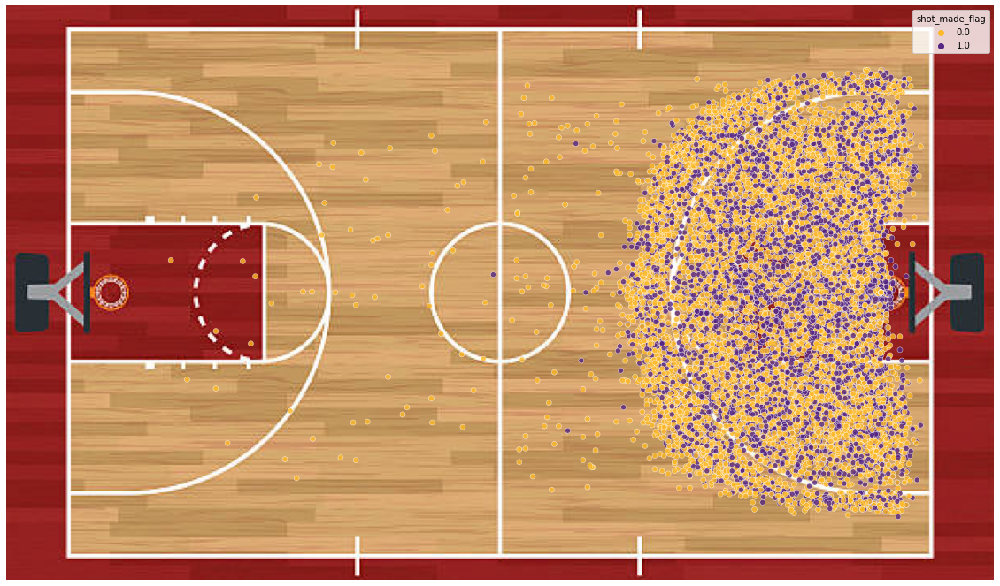

In [9]:
## Create array of Laker colors
cols = ['#FDB927','#552583']
## Transform into palette
pal = sns.color_palette(cols)

# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = kb, x = 'lat', y = 'lon',  hue = 'shot_made_flag', alpha = 0.8, palette = pal);

This is the career of a professional basketball player visualized. 

Purely based on observation, it seems that Kobe performed the majority of his shots from within the three-point line. It also looks like there is no clear relationship between his successful shots and where along the extended free throw line he was (i.e his location along the y-axis did not seem to matter). 

### 1.5: The Target Feature

In [10]:
kb.shot_made_flag.value_counts()

0.0    14232
1.0    11465
Name: shot_made_flag, dtype: int64

Ignoring the observations in the test set, it seems that Kobe missed slightly more shots than he made, averaging around a 44.6% shot completion rate. As is expected, the target feature calls for binary classification, and there is no need for any form of transformation.

## 2: Splitting the Data

### 2.1: Separate Testing Set Based on Aforementioned Kaggle Requirements

In [11]:
## Find observations with missing shot_made_flag values
test_index = kb[kb.shot_made_flag != kb.shot_made_flag].index

## split between overall train and testing sets
train = kb.drop(index=test_index)
test = kb.loc[test_index]

## Break further into X and y for each
X, y = train.drop(['shot_made_flag'], axis = 1), train.shot_made_flag
Xte, yte = test.drop(['shot_made_flag'], axis = 1), test.shot_made_flag

### 2.2: Split Remaining Observations into Training and Validation Sets

In [57]:
from sklearn.model_selection import train_test_split
Xtr, Xval, ytr, yval = train_test_split(X, y, test_size = 0.3, random_state = 1)

Now that we have our training, testing, and validation sets, we can safely perform some EDA.

## 3: Exploratory Data Analysis (EDA)

### 3.1: Shot Distance

Let's look at my prior concerns about potential irregularities in the shot_distance feature. 

Remember that the lowest value was zero, which I was worried may have been a standin for a missing value. That said, it is more likely that these values represent dunks made by Kobe. We'll be making sure. 

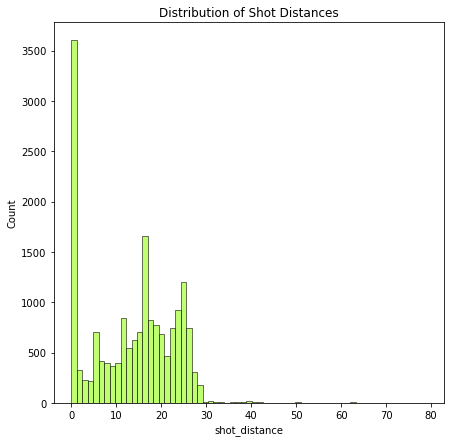

In [58]:
plt.figure(figsize=(7,7))
sns.histplot(Xtr.shot_distance, color = '#AAFD42')
plt.title("Distribution of Shot Distances");

Its clear that most of the our shots occurred from at the net. These can include dunks, layups, and close shots. Let's get a little bit of accounting done.

In [14]:
Xtr['action_type'].value_counts().head(10)

Jump Shot                   11132
Layup Shot                   1501
Driving Layup Shot           1148
Turnaround Jump Shot          614
Fadeaway Jump Shot            609
Running Jump Shot             509
Pullup Jump shot              293
Turnaround Fadeaway shot      261
Reverse Layup Shot            241
Slam Dunk Shot                237
Name: action_type, dtype: int64

In [15]:
#Our dunks
Xtr['action_type'][Xtr['action_type'].str.contains('Dunk')].value_counts().sum()

727

In [16]:
# Our layups
Xtr['action_type'][Xtr['action_type'].str.contains('Layup')].value_counts().sum()

3112

Although I didn't specifically account for each observation with a shot range of 0, seeing this, along with the physical distribution of shots, you can tell that those values are genuine rather than missing.

How does the shot's distance relate to its scoring chance?

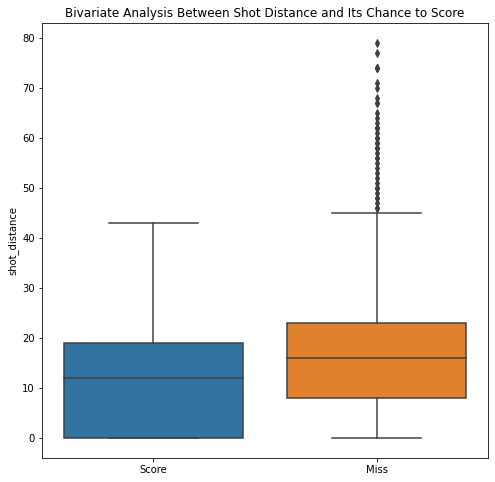

In [17]:
plt.figure(figsize=(8,8))
sns.boxplot(x = np.where(ytr == 1, 'Score', 'Miss'), y = Xtr.shot_distance)
plt.title('Bivariate Analysis Between Shot Distance and Its Chance to Score');

You could likely guess that a shot's distance influenced whether or not it would be a field goal or miss. This boxplot just confirms that relationship.

### 3.2: Action Type vs Combined Shot Type

Next up we have two categorical features; at first blush, action shot and shot type seem very similar since both essentially describe the type of shot performed by Kobe. If they do overlap to this degree, then we'll need to choose one or the other later on.

Let's look at both:

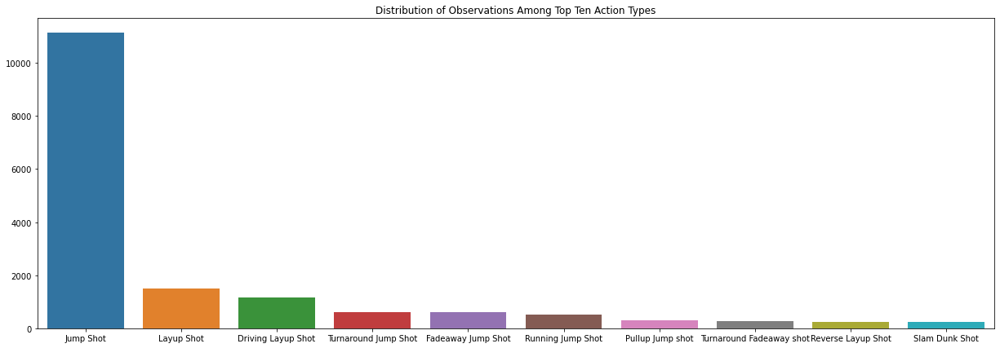

In [18]:
temp = Xtr.action_type.value_counts().sort_values(ascending = False).head(10)
plt.figure(figsize = (21,7))
sns.barplot(x = temp.index, y = list(temp))
plt.title("Distribution of Observations Among Top Ten Action Types");

From this point onwards, the distribution becomes more skewed until we get to categories that consist of one observations. This is a paretto distribution in a nutshell. 

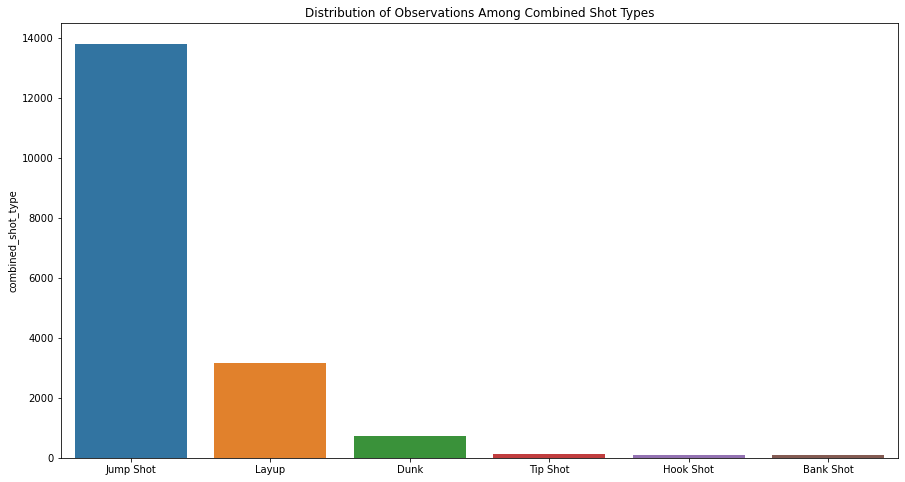

In [19]:
temp = Xtr.combined_shot_type.value_counts().sort_values(ascending = False)

plt.figure(figsize = (15,8))
sns.barplot(x = temp.index, y = temp)
plt.title('Distribution of Observations Among Combined Shot Types');

As the feature name suggests, this attribute combines the categories of the prior setup. 


This means that there is significant overlap between the two; we will need to look at both's relationship with the target feature before picking one or the other.

In [20]:
pd.crosstab(index = Xtr.action_type, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False).head(10)

col_0,Miss,Score
action_type,,
Jump Shot,7504,3628
Driving Layup Shot,299,849
Layup Shot,927,574
Running Jump Shot,119,390
Turnaround Jump Shot,244,370
Fadeaway Jump Shot,261,348
Slam Dunk Shot,5,232
Pullup Jump shot,78,215
Driving Dunk Shot,3,172


Although it is difficult to see and calculate all of these categories (there are over fifty of them), they do a great job in discriminating between shots that miss and those that do not. 

For example, you can be reasonably sure that a driving layup shot would score; on the other hand, the combined shot type variable below aggregate layups into one category, which is far more mixed. The granularity of the prior's categories make it a more powerful option.

In [21]:
pd.crosstab(index = Xtr.combined_shot_type, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)

col_0,Miss,Score
combined_shot_type,,
Jump Shot,8423,5386
Layup,1386,1786
Dunk,55,672
Bank Shot,21,56
Hook Shot,41,47
Tip Shot,74,40


### 3.3: Shot Type

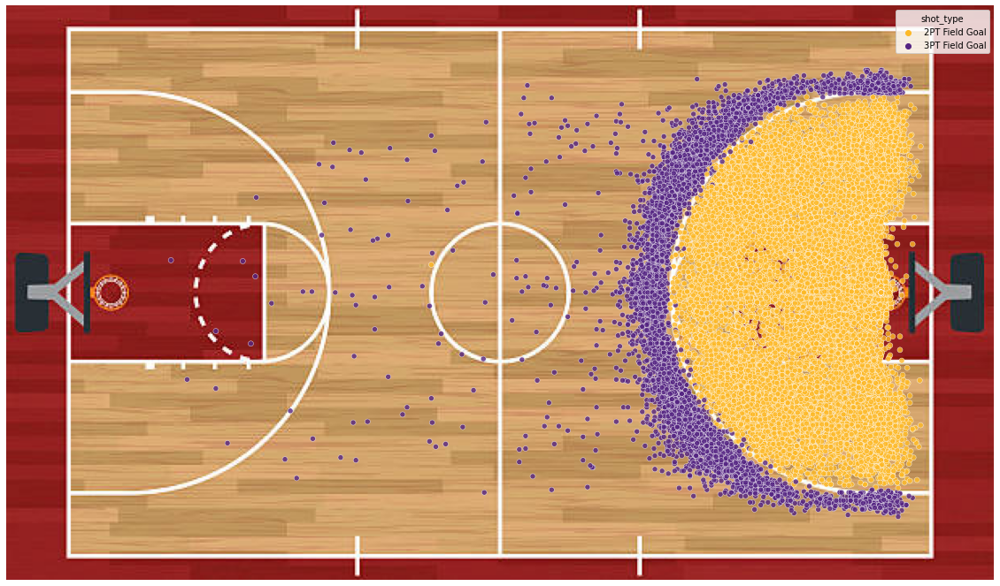

In [22]:
## Create array of Laker colors
cols = ['#FDB927','#552583']
## Transform into palette
pal = sns.color_palette(cols)

# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = kb, x = 'lat', y = 'lon',  hue = 'shot_type', alpha = 0.8, palette = pal);

In [23]:
pd.crosstab(index = Xtr.shot_type, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)

col_0,Miss,Score
shot_type,,
2PT Field Goal,7396,6700
3PT Field Goal,2604,1287


I'm bringing back our prior image to showcase this feature. 

Although there is a clear connection between the type of shot made and its percent chance to become a field goal, there is also a relationship between it and the shot distance showcased earlier. The two features are covariant, meaning this feature will be dropped later on.

### 3.4: Shot Zone Area

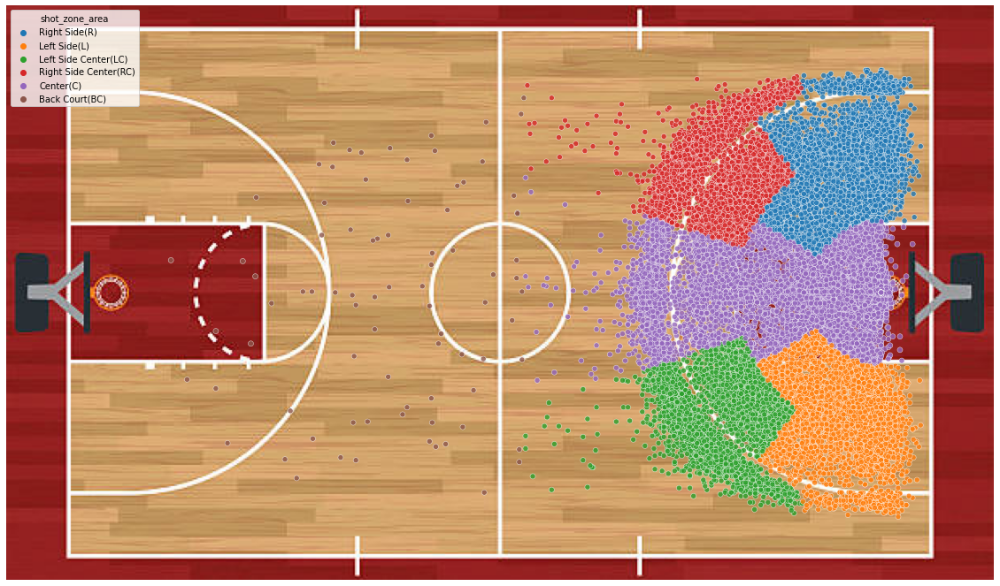

In [24]:
# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = kb, x = 'lat', y = 'lon',  hue = 'shot_zone_area', alpha = 0.8);

In [25]:
pd.crosstab(index = Xtr.shot_zone_area, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)

col_0,Miss,Score
shot_zone_area,,
Center(C),3774,4134
Right Side(R),1597,1083
Right Side Center(RC),1712,1076
Left Side Center(LC),1560,848
Left Side(L),1305,845
Back Court(BC),52,1


Although this feature suffers from the same potential for covariance with shot distance that shot type did, this variable differentiates itself by incorporating the shot angle into the equation. 

For example, it's clear that Kobe managed greater success when shooting from the center rather than the left or right, despite the fact that they (mostly) were taken from comparable ranges. Since there is no shot angle attribute, we should keep shot zone area as a supplement. 

## 4: Feature Engineering and Selection

Although we've run through and selected (or disqualified) a few features, those decisions were pretty straightforward, and they were direct byproducts of my exploratory data analysis. In this next section, we will be looking through other attributes that either need to be altered or have a more complicated relationship with others in the set.

### 4.1: Season and Game Date

In [26]:
temp = pd.concat((Xtr[['season','game_date']], ytr), axis = 1)
temp.head()

,season,game_date,shot_made_flag
11204,2006-07,2007-04-01,1.0
18720,2011-12,2012-02-10,0.0
750,2000-01,2001-01-03,1.0
4490,2002-03,2003-02-28,0.0
15592,2009-10,2010-01-01,0.0


Heree we have two features that represent a similar aspect of Kobe's performance, specifically when throughout his career he made a shot. Season represents this as a categorical feature while game date does so more continuously. 

This is a time series, so I'm going to see if there is a trend or seasonality associated with it.

In [27]:
temp['game_date'] = pd.to_datetime(temp['game_date'])
temp['score_pct'] = temp.groupby('game_date')['shot_made_flag'].transform('mean')
temp['shot_count'] = temp.groupby('game_date')['shot_made_flag'].transform('size')
temp['year'] = temp.game_date.dt.year
temp['month'] = temp.game_date.dt.month

In [28]:
temp.sort_values('game_date').head()

,season,game_date,shot_made_flag,score_pct,shot_count,year,month
22901,1996-97,1996-11-03,0.0,0.0,1,1996,11
22902,1996-97,1996-11-05,0.0,0.0,1,1996,11
22905,1996-97,1996-11-06,1.0,1.0,2,1996,11
22903,1996-97,1996-11-06,1.0,1.0,2,1996,11
22911,1996-97,1996-11-08,0.0,0.4,5,1996,11


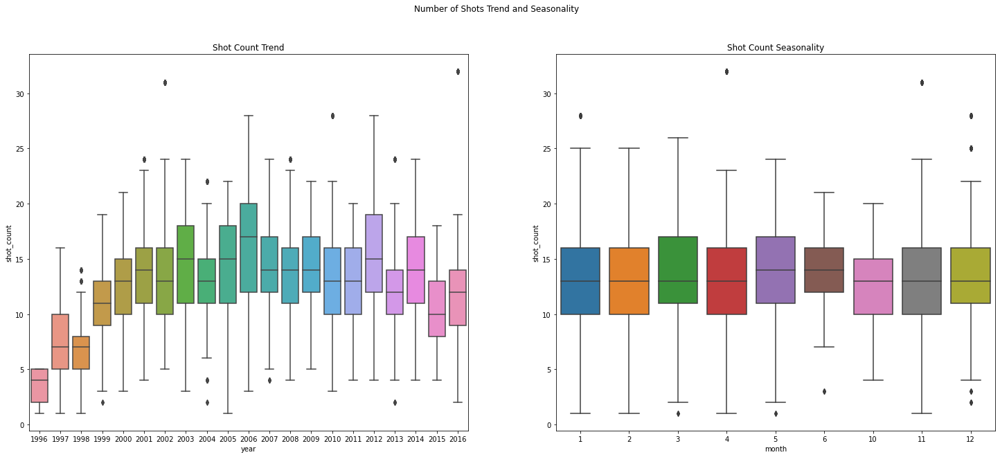

In [29]:
years = temp['year'].unique()
fig, (ax, ax2) = plt.subplots(1,2, figsize = (25,10))
sns.boxplot(data = temp, x = 'year', y = 'shot_count', ax = ax)
sns.boxplot(data = temp, x = 'month', y = 'shot_count', ax = ax2)
plt.suptitle("Number of Shots Trend and Seasonality")
ax.title.set_text('Shot Count Trend')
ax2.title.set_text("Shot Count Seasonality");

When you look at the distribution of the number of shots Kobe took per game, you can see how as his career took off he began to take a greater number. Predictably, there is no seasonal component to his performance. 

How does his accuracy change?

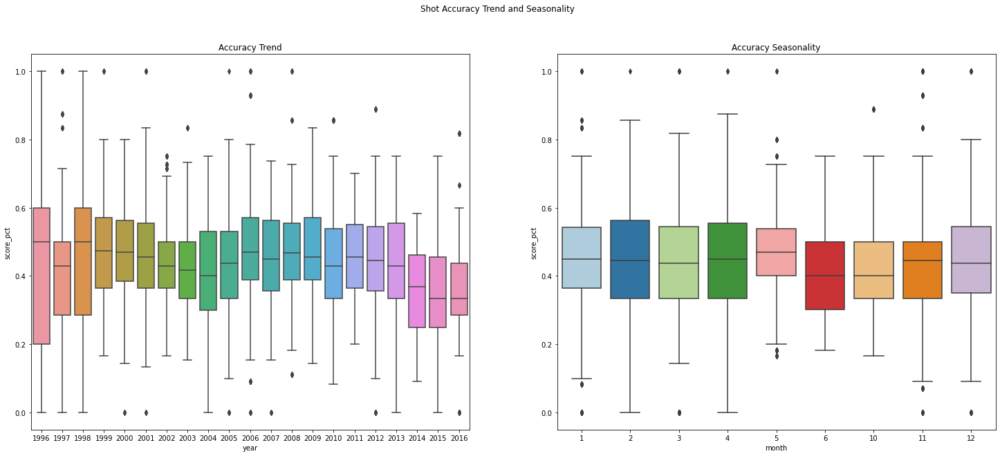

In [30]:
fig, (ax, ax2) = plt.subplots(1,2, figsize = (25,10))
sns.set_palette(sns.color_palette("Paired"))
sns.boxplot(data = temp, x = 'year', y = 'score_pct', ax = ax)
sns.boxplot(data = temp, x = 'month', y = 'score_pct', ax = ax2)
plt.suptitle("Shot Accuracy Trend and Seasonality")
ax.title.set_text('Accuracy Trend')
ax2.title.set_text("Accuracy Seasonality");

This relationship is a little bit harder to read. There does seem to be a slight trend where Kobe became more accurate as we grew into his career before dropping slightly after 2013. Again, there is no seasonality to this relationship.

In short, this set of features can be boiled down to the predictive power of the season Kobe played in. Let's look closer at it. 

In [31]:
temp = pd.to_numeric(Xtr.season.str.replace('-..', '', regex = True))

In [32]:
temp.sort_values().head()

23207    1996
23159    1996
30054    1996
23194    1996
23038    1996
Name: season, dtype: int64

In [33]:
temp.head()

11204    2006
18720    2011
750      2000
4490     2002
15592    2009
Name: season, dtype: int64

In [34]:
temp = pd.crosstab(index = temp, columns = np.where(ytr == 1, 'Score', 'Miss'))
temp['Ratio'] = temp['Score']/(temp['Miss'] + temp['Score'])
temp.Ratio.describe()

count    20.000000
mean      0.438243
std       0.032334
min       0.352665
25%       0.426512
50%       0.448060
75%       0.459386
max       0.478102
Name: Ratio, dtype: float64

It seems that the late-90s and early 2000s were pretty good years for Kobe's accuracy. There's a decent range invovled with this feature, but the deviation is not that high. We'll keep the season feature for the model, but the game date and the seasonality components can be dropped.

### 4.2: What About Playoffs?

In [35]:
temp = pd.crosstab(index = Xtr.playoffs, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)
temp['Ratio'] = temp['Score']/(temp['Miss'] + temp['Score'])
temp

col_0,Miss,Score,Ratio
playoffs,,,
0,8543,6816,0.443779
1,1457,1171,0.445586


Generally, Kobe didn't seem to be affected by playoff pressure. These results would push us towards getting rid of the featureas a predictive variable.

### 4.3: In-Game Temporal Features

Our next features are all connected in that they describe the points during individual games that Kobe made or missed a shot. What's interesting about these features is that there is an argument to both combine them into one overall clock and not to. 

For: Combinging them all into one would allow us to track shots continuously throughout the game.

Against: This is not exactly how basketball works; shots are more likely to happen as the timer runs down, especially as the number of periods drags on. A continuous clock would falter when explaining hopeful shots made just before halftime and the like.

In [36]:
temp = Xtr[['minutes_remaining','period','seconds_remaining']]
temp.head()

,minutes_remaining,period,seconds_remaining
11204,2,2,48
18720,3,4,19
750,4,4,42
4490,3,2,52
15592,7,2,6


Continuous intervals interrupted by quarter starts and stops seems to be the best way forward. I will merge the minutes and seconds features into one but leave the quarter variable alone. In short, I will be treating this also like a time series.

In [37]:
temp['seconds_remaining_in_quarter'] = (pd.to_numeric(temp['minutes_remaining'])*60)+(pd.to_numeric(temp['seconds_remaining']))
temp = pd.concat((temp, ytr), axis = 1)
temp['score_pct'] = temp.groupby('minutes_remaining')['shot_made_flag'].transform('mean')
temp[['period','seconds_remaining_in_quarter','shot_made_flag','score_pct']].head()

<ipython-input-37-b8b1772981d4>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp['seconds_remaining_in_quarter'] = (pd.to_numeric(temp['minutes_remaining'])*60)+(pd.to_numeric(temp['seconds_remaining']))


,period,seconds_remaining_in_quarter,shot_made_flag,score_pct
11204,2,168,1.0,0.434657
18720,4,199,0.0,0.446602
750,4,282,1.0,0.457383
4490,2,232,0.0,0.446602
15592,2,426,0.0,0.481259


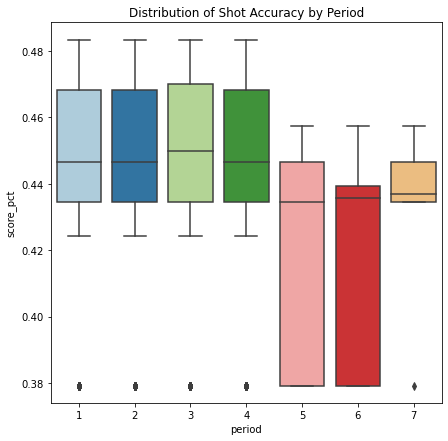

In [38]:
plt.figure(figsize = (7,7))
sns.boxplot(x = temp['period'], y = temp['score_pct'])
plt.title("Distribution of Shot Accuracy by Period");

There's a clear difference in shot quality by period, primarily between "normal" periods and irregular ones. 

How does the minute marker affect performance?

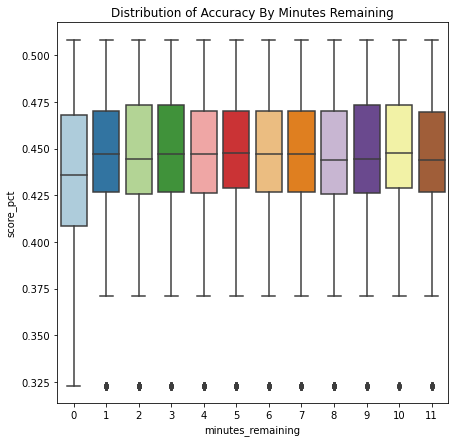

In [39]:
temp['score_pct'] = temp.groupby('seconds_remaining')['shot_made_flag'].transform('mean')

plt.figure(figsize=(7,7))
sns.boxplot(x = temp['minutes_remaining'], y = temp['score_pct'])
plt.title("Distribution of Accuracy By Minutes Remaining");

We seem to have reasonably consistent performance across minutes throughout a quarter with one exception. As the last minute runs down, the accuracy suffers. 

Remember that many shots were attempted in the last second; these would reasonably have a lower accuracy than their normal counterparts, so we should create a feature that differentiates the two. 

### 4.4: Last-Second Shot

In [40]:
last_second = Xtr[(Xtr['seconds_remaining'] == 0) & (Xtr['minutes_remaining'] == 0)]
last_second_shot = ytr.loc[last_second.index]

temp = pd.concat((last_second, last_second_shot), axis = 1)

In [41]:
second = temp.shot_made_flag.mean()
second

0.18506493506493507

The average scoring rate for shots made in the last second are just under 20%. This is a clear drop in accuracy from the general average, but we are representing a small subsection of the total population (~600 vs. 36000). 

What if we check how all shots in the final minute compare?

In [42]:
last_minute = Xtr[Xtr['minutes_remaining'] == 0]
last_minute_shot = ytr.loc[last_minute.index]

temp = pd.concat((last_minute, last_minute_shot), axis = 1)

In [43]:
minute = temp.shot_made_flag.mean()
minute

0.3792196405085489

The average scoring rate for shots made in the last minute is significantly higher than the last second but not as high as the general average. This makes intuitive sense since the last minute is a middle ground between normal play and a desperate shot at the last second. 

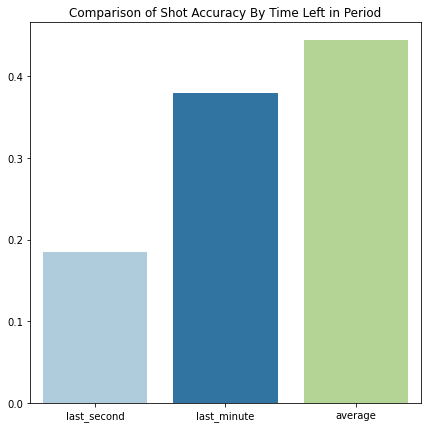

In [44]:
plt.figure(figsize = (7,7))
sns.barplot(x = ['last_second', 'last_minute', 'average'], y = [second, minute, ytr.mean()])
plt.title("Comparison of Shot Accuracy By Time Left in Period");

It seems that both the last second and last minute shots would be beneficial in classifying a shot as being a field goal or a miss, but they would likely have a fair degree of covariance. Let's see if its a problem.

In [45]:
temp1 = pd.Series(np.where((Xtr['seconds_remaining'] == 0) & (Xtr['minutes_remaining'] == 0), 1, 0))
temp2 = pd.Series(np.where(Xtr['minutes_remaining'] == 0, 1, 0))

pd.concat((temp1, temp2), axis = 1).corr()

,0,1
0,1.000000,0.346351
1,0.346351,1.000000


With a correlation of 0.35, they have a little bit of covariance but not enough to be considered problematic alone. We'll add both features.

### 4.5: Game Location

Next up, how does the game's location affect Kobe's shot performance? Does he have a home turf advantage?

In [46]:
temp = pd.concat((Xtr['matchup'], ytr), axis = 1)
temp['game_loc'] = np.where(Xtr['matchup'].str.contains('@'), 0, 1)

In [47]:
temp.head()

,matchup,shot_made_flag,game_loc
11204,LAL vs. SAC,1.0,1
18720,LAL @ NYK,0.0,0
750,LAL vs. UTA,1.0,1
4490,LAL @ SEA,0.0,0
15592,LAL vs. SAC,0.0,1


In [48]:
temp = pd.crosstab(temp['game_loc'], temp['shot_made_flag'])
temp['score_pct'] = temp.loc[:,1]/(temp.loc[:,1]+temp.loc[:,0])
temp

shot_made_flag,0.0,1.0,score_pct
game_loc,,,
0,5191,4011,0.435884
1,4809,3976,0.452590


Surprisingly, there does not seem to be a difference between Kobe's performance away versus at home. 

### 4.6: Opponent Quality

The quality of the opposing team is also a theoretical factor for the number of shots Kobe would make versus miss. 

In [49]:
temp = pd.concat((Xtr, ytr), axis = 1)
temp['score_pct_by_game'] = temp.groupby('game_event_id')['shot_made_flag'].transform('mean')
temp['score_pct'] = temp.groupby('opponent')['shot_made_flag'].transform('mean')
temp[['opponent','score_pct']].drop_duplicates().sort_values('score_pct').head()

,opponent,score_pct
9899,MIL,0.398892
6295,NOP,0.400000
3204,BOS,0.408503
8250,WAS,0.411079
17007,MIA,0.414773


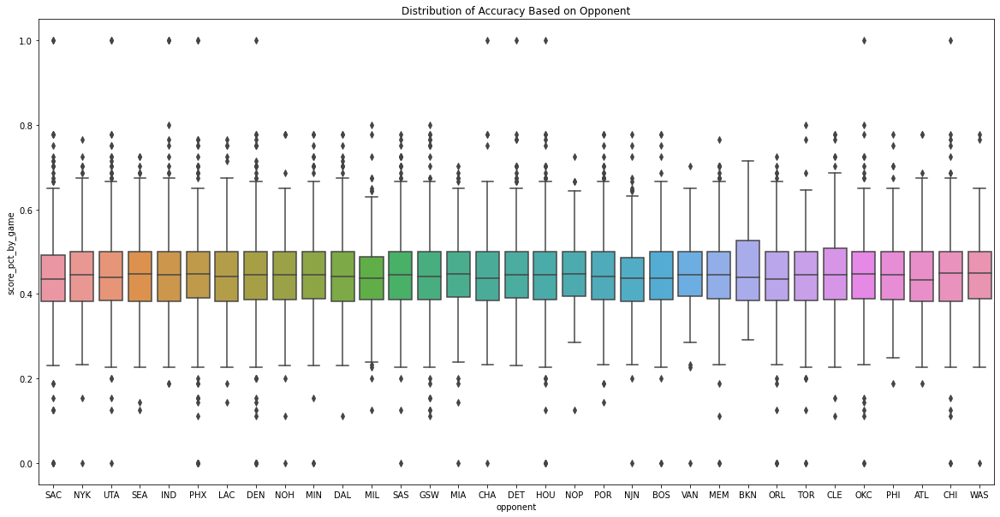

In [50]:
plt.figure(figsize = (20,10))
sns.boxplot(x = temp['opponent'], y = temp['score_pct_by_game'])
plt.title("Distribution of Accuracy Based on Opponent");

According to the shot scoring percentage by team, there seemed to be a noticeable difference in performance based on the opponent Kobe faced. With that being said, if you look at the distribution of field goal percentage on a per-team basis, there is no clear relationship.

We'll remove opponents as a predictive feature. 

## 5: Setting up the Pipeline

### 5.1: What are our Features? (Summary)

1. Shot Type: What type of shot style did Kobe use? (layup, dunk, hook shot?)

2. Period: What point of the game did he shoot?

3. Shot Zone: At what section of the court was Kobe situated when he shot?

4. Shot Distance: How far was he from the hoop?

4. Season: At what stage of his career did he make that shot?

5. Last Second Check: Was the shot made as the clock ran out?

6. Last Minute Check: Was it made when the clock was running out?

In [51]:
## Created and Altered Variables

### Transform season into an integer
def season_integer(df):
    df.season = pd.to_numeric(df.season.str.replace('-..', '', regex = True))
    return df
### Create the last minute and last second attributes
def last_minute_and_second(df):
    df['last_second_shot'] = np.where((df['seconds_remaining'] == 0) & (df['minutes_remaining'] == 0), 1, 0)
    df['last_minute_shot'] = np.where(df['minutes_remaining'] == 0, 1, 0)
    return df
def select_features(df):
    features = ['combined_shot_type','period','shot_zone_basic','shot_distance','season','last_second_shot','last_minute_shot']
    df = df[features]
    return df

In [52]:
from sklearn.base import BaseEstimator, TransformerMixin

class SeasonInteger(BaseEstimator, TransformerMixin):
    def __init___(self, season_int = True):
        self.season_int = season_int
    def fit(self, X, y = None):
        return self
    def transform(self, X):
        season = pd.to_numeric(X.str.replace('-..', '', regex = True))
        return pd.DataFrame(season)

class LastMin(BaseEstimator, TransformerMixin):
    def __init__(self, make_vars = True):
        self.make_vars = make_vars
    def fit(self, X, y = True):
        return self
    def transform(self, X):
        last_minute_shot = np.where(X[:,17] == 0, 1, 0)
        X[:,17] = last_minute_shot
        return X
class LastSec(BaseEstimator, TransformerMixin):
    def __init__(self, make_vars = True):
        self.make_vars = make_vars
    def fit(self, X, y = True):
        return self
    def transform(self, X):
        last_second_shot = np.where((X[:,16]== 0) & (X[:,17] == 0), 1, 0)
        X[:,16] = last_second_shot
        return X

### 5.2: Transformation Functions

In [53]:
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

In [54]:
cols = make_column_transformer(
    (SeasonInteger(), 'season'),
    (StandardScaler(),['shot_distance','period']),
    (OneHotEncoder(), ['combined_shot_type','shot_zone_basic']),
    ('passthrough', ['seconds_remaining','minutes_remaining'])
)

pipes = make_pipeline(
    cols,
    LastMin(),
    LastSec(),
    StandardScaler()
)

### 5.3: Applying the Column Transformer to the Training and Validation Sets

In [55]:
Xtr = pipes.fit_transform(Xtr)
Xval = pipes.transform(Xval)

# TODO

1. Model
2. Ensemble
3. Apply to Test Set
4. Add more introduction (ie Kaggle Description and the like)